In [1]:
import pandas as pd
import geopandas as gpd
import folium
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
from IPython.display import Markdown as md, HTML

from nycschools import schools, ui, geo
from nycschools.dataloader import load
import warnings
warnings.filterwarnings('ignore')

In [2]:
from IPython.display import HTML
colors = {
    "mixed": "blue",
    "other": "grey",
    "pacific": "green",
    "white": "cyan",
    "black": "orange",
    "indian": "pink",
    "latino": "purple",
    "asian": "red",
}
keys = sorted(colors.keys())
legend = "".join([f"<span style='width: 10px height: 10px; color: {colors[k]}></span><span style='padding: .em; font-size: 10px'>{k}</span>" for k in keys])
HTML(legend)

In [3]:
from IPython.display import HTML

colors = {
    "mixed": "blue",
    "other": "grey",
    "pacific": "green",
    "white": "cyan",
    "black": "orange",
    "indian": "pink",
    "latino": "purple",
    "asian": "red",
}

keys = sorted(colors.keys())
keys = ['asian', 'black', 'latino', 'white']

# Build HTML string for the legend
legend = "\n".join([
    f"<span style='display: inline-block; width: 20px; height: 20px; background-color: {colors[k]}; margin-right: 5px;'></span>"
    f"<span style='padding-right: 1em; font-size: 12px;'>{k.title()}</span>"
    for k in keys
])
print(legend)
# Display the legend using HTML
HTML(f"""
<div style="background-color: white; color: black; font-weight: bold; padding: .5em">
<span style='display: inline-block; width: 20px; height: 20px; background-color: red; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 16px;'>Asian</span>
<span style='display: inline-block; width: 20px; height: 20px; background-color: orange; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 16px;'>Black</span>
<span style='display: inline-block; width: 20px; height: 20px; background-color: purple; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 16px;'>Latinx</span>
<span style='display: inline-block; width: 20px; height: 20px; background-color: cyan; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 16px;'>White</span></div>
     """)

<span style='display: inline-block; width: 20px; height: 20px; background-color: red; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 12px;'>Asian</span>
<span style='display: inline-block; width: 20px; height: 20px; background-color: orange; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 12px;'>Black</span>
<span style='display: inline-block; width: 20px; height: 20px; background-color: purple; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 12px;'>Latino</span>
<span style='display: inline-block; width: 20px; height: 20px; background-color: cyan; margin-right: 5px;'></span><span style='padding-right: 1em; font-size: 12px;'>White</span>


In [4]:

# create a new column for the total population in each tract by summing the values in race_cols
data["pop"] = data.asian + data.black + data.indian + data.latino + data.mixed + data.other + data.pacific + data.white
print(f"""Total population NYC: {data["pop"].sum():,}""")
tracts = data[data["pop"] > 0]
tracts["pop"].describe()

NameError: name 'data' is not defined

In [4]:
# generate random, colored point locations for every 10 people in school district 13 and bordering areas
colors = {
    "mixed": "blue",
    "other": "grey",
    "pacific": "green",
    "white": "cyan",
    "black": "orange",
    "indian": "pink",
    "latino": "purple",
    "asian": "red",
}
N = data["pop"].sum()
asian_pct = data["asian"].sum() / N
black_pct = data["black"].sum() / N
indian_pct = data["indian"].sum() / N
latino_pct = data["latino"].sum() / N
mixed_pct = data["mixed"].sum() / N
other_pct = data["other"].sum() / N
pacific_pct = data["pacific"].sum() / N
white_pct = data["white"].sum() / N

In [6]:


def make_rand_points(row):
    scale = 150
    results = []
    for group, color in colors.items():
        num_points = row[group] // scale
        if num_points > 0:
            points = ui.rand_points(row.geometry, num_points)
            points["group"] = group
            points["color"] = color
            results.append(points)
    return pd.concat(results) if results else pd.DataFrame()



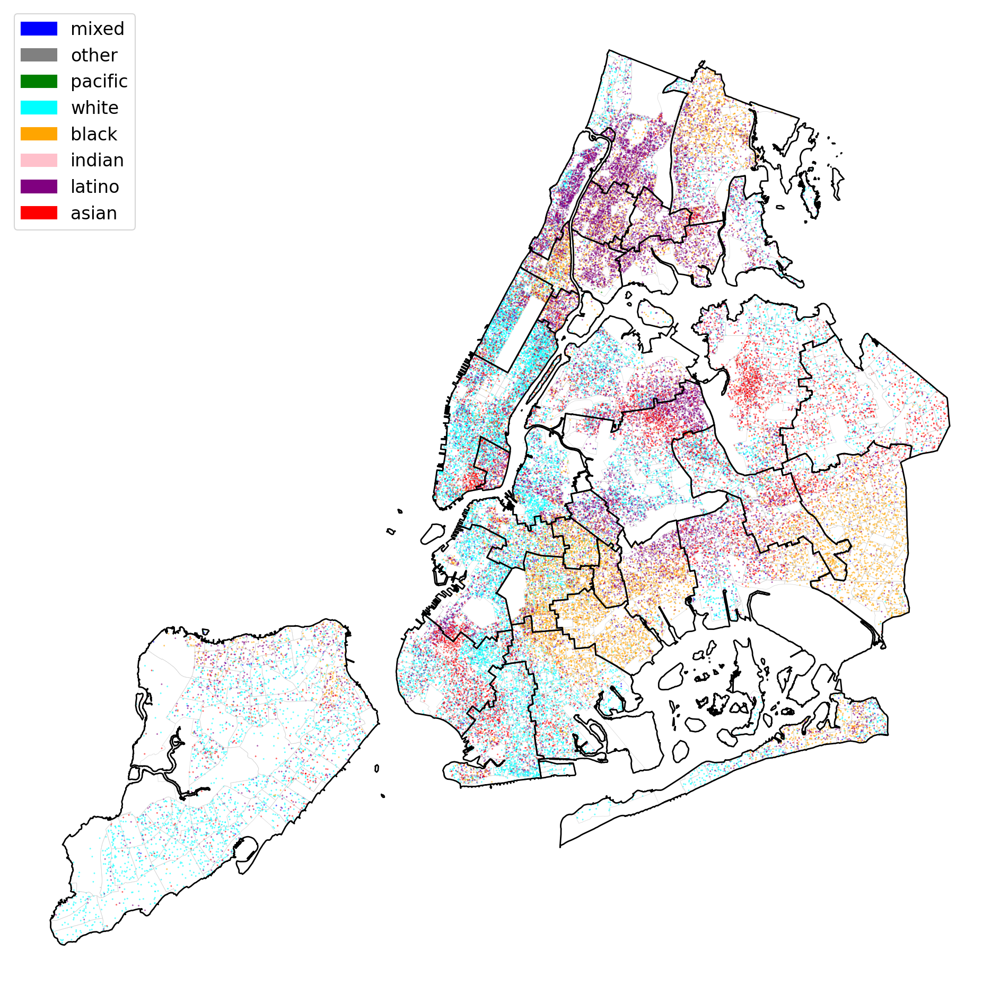

In [13]:

def make_dot_map(data, colors, districts):

    points = data.apply(make_rand_points, axis=1).tolist()
    points = pd.concat(points)
    points = gpd.GeoDataFrame(points, geometry='geometry', crs=data.crs)

    fig_scale = 1.2
    fig, ax = plt.subplots(1, 1, figsize=(16*fig_scale, 16*fig_scale))
    sns.set_context('talk')
    plt.axis('off')
    fig.tight_layout()

    # plot the points
    _ = points.plot(ax=ax, color=points.color, facecolor=points.color, markersize=.2, alpha=1)
    # plot census tracts in light gray
    _ = data.plot(ax=ax, facecolor="none", edgecolor='lightgray', linewidth=0.5)

    # plot school district boundaries
    _ = districts.plot(ax=ax, facecolor="none", edgecolor='black', linewidth=2)

    patches = [mpatches.Patch(color=color, label=label) for label, color in colors.items()]
    _ = ax.legend(handles=patches, loc='upper left', fontsize=24)

    return fig, ax
fig, ax = make_dot_map(tracts, colors, districts)
fig.savefig("nyc-dots.png")

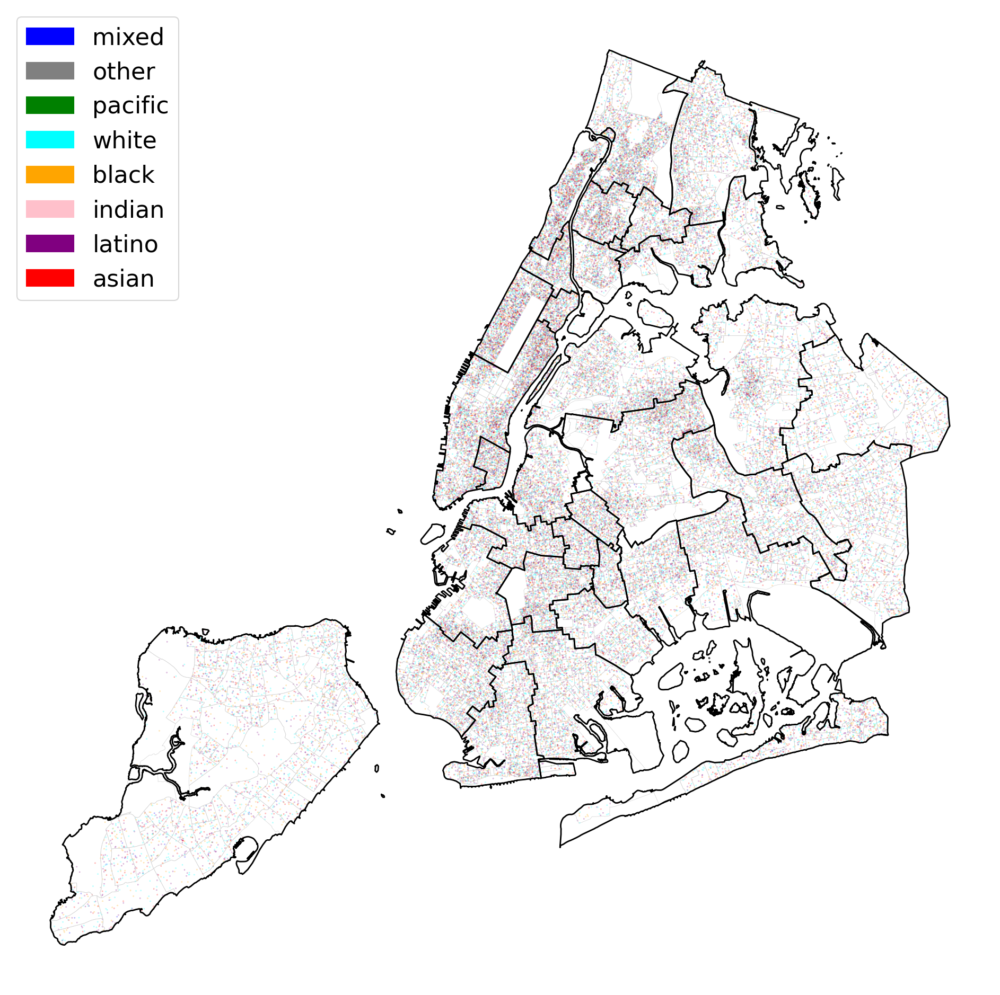

In [12]:



# recalculate the tracts to match the city's population
entropy = data.copy()
entropy["asian"] = (entropy["pop"] * asian_pct).astype(int)
entropy["black"] = (entropy["pop"] * black_pct).astype(int)
entropy["indian"] = (entropy["pop"] * indian_pct).astype(int)
entropy["latino"] = (entropy["pop"] * latino_pct).astype(int)
entropy["mixed"] = (entropy["pop"] * mixed_pct).astype(int)
entropy["other"] = (entropy["pop"] * other_pct).astype(int)
entropy["pacific"] = (entropy["pop"] * pacific_pct).astype(int)
entropy["white"] = (entropy["pop"] * white_pct).astype(int)

entropy["pop"].sum(), sum([entropy["asian"].sum(), entropy["black"].sum(), entropy["indian"].sum(), entropy["latino"].sum(), entropy["mixed"].sum(), entropy["other"].sum(), entropy["pacific"].sum(), entropy["white"].sum()])
entropy = entropy[entropy["pop"] > 0]
fig, ax = make_dot_map(entropy, colors, districts)
fig.savefig("nyc-entropy-dots.png")

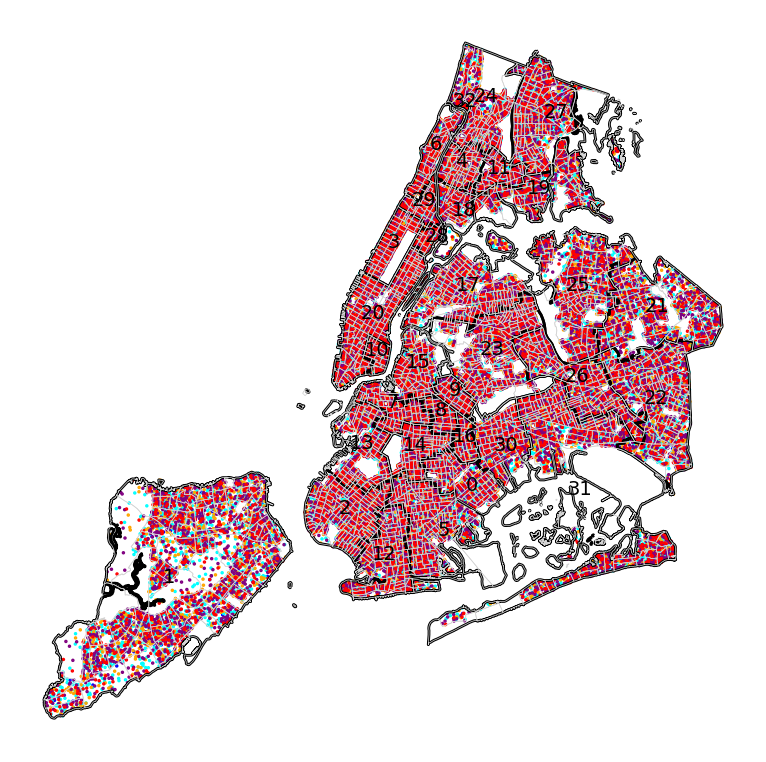

In [42]:

points = entropy.apply(make_rand_points, axis=1).tolist()
points = pd.concat(points)
points = gpd.GeoDataFrame(points, geometry='geometry', crs=data.crs)

fig, ax = plt.subplots(1, 1, figsize=(16*fig_scale, 16*fig_scale))
sns.set_context('talk')
plt.axis('off')
fig.tight_layout()

# plot the points
_ = points.plot(ax=ax, color=points.color, markersize=1)

# plot school district boundaries
_ = districts.plot(ax=ax, facecolor="none", edgecolor='black', linewidth=2)

# annotate with district number
districts["xy"] = districts.geometry.centroid.apply(lambda x: x.coords[0])
_ = districts.apply(lambda row: ax.annotate( row.name, xy=row.xy, ha='center', fontsize=14), axis=1)

# plot census tracts in light gray
_ = data.plot(ax=ax, facecolor="none", edgecolor='lightgray', linewidth=0.5)
fig.savefig("nyc-entropy-dots.png")

In [73]:
info = ["dbn", "school_name", "total_enrollment", "plurality", "black_pct", "hispanic_pct", "white_pct", "asian_pct", "poverty_pct"]
feet = feet[["dbn", "geometry"]].merge(d13[info + ["color"]], on="dbn", how="inner").reset_index(drop=True)
feet = feet.drop_duplicates(subset="dbn")

In [ ]:

feet["title"] = feet.apply(lambda x: f"{x['dbn']} ({x[x['plurality']+"_pct"]:.0%} {x['plurality'].title()})", axis=1)
feet["info"] = feet.apply(ui.popup(info), axis=1)
# map the school color onto the plurality
d13["color"] = d13.plurality.map(colors)
d13.plurality = d13.plurality.apply( lambda x: "Latinx" if x == "hispanic" else x.capitalize())
feet.plurality = feet.plurality.str.capitalize()


In [75]:

m = feet.explore(m=dot_map, color="color", tooltip="title", popup="info", style_kwds={"fillOpacity": 1, "opacity": 0})

m

In [12]:
m.save("d13-dot-density-demographics.html")